In [10]:
rm -rf *.csv
# things to try
# unstretch dtw
# compare the full version and the karaoke version


In [5]:
import librosa, librosa.display, numpy
#just a dream: Estimated tempo: 89.10 beats per minute
# river: Estimated tempo: 152.00 beats per minute
river_rate = 152 / 2 # hardcoded 2
dream_rate = 89.1
rate = dream_rate / river_rate
print(rate)

1.1723684210526315


In [6]:
filename = 'river_flow_in_you_beat_mono.wav'
y, sr = librosa.load(filename)
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
print('Estimated tempo: {:.2f} beats per minute'.format(tempo))
beat_times = librosa.frames_to_time(beat_frames, sr=sr)
print('Saving output')
librosa.output.times_csv(filename + '_beat_times.csv', beat_times)

Estimated tempo: 152.00 beats per minute
Saving output


In [7]:
filename_2 = 'just_a_dream_vocal_mono.wav'
x, x_sr = librosa.load(filename_2)

In [8]:
total_time_s = len(y) / sr # 203.7338321995465
start_cut_time_s = 24.427
end_cut_time_s = 203.244
print("length y:", len(y))
start_cut_time = int(start_cut_time_s * sr)
end_cut_time = int(end_cut_time_s * sr)
print("start_cut_instance:", start_cut_time, "end_cut_instance:", end_cut_time)

print("start stretching:")
y_fast = librosa.effects.time_stretch(y, rate)
print("writing to output")
outputfile = filename.strip(".wav") + "_stretch" + ".wav"
librosa.output.write_wav(outputfile, y_fast, sr) 

length y: 4492331
start_cut_instance: 538615 end_cut_instance: 4481530
start stretching:
writing to output


shape (12, 1292)


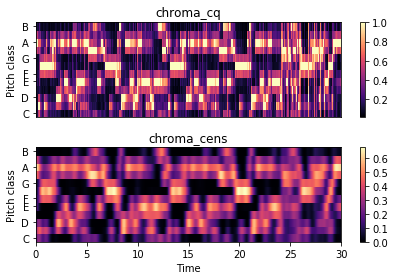

In [20]:
# calculate and plot chroma of y (river flows in you)
hop_length = 256

cut_off_time = 30

showing = y[:cut_off_time *sr]
# showing =y 
y_chroma_cens = librosa.feature.chroma_cens(y=showing, sr=sr)
y_chroma_cq = librosa.feature.chroma_cqt(y=showing, sr=sr)

y_cqt = librosa.cqt(showing, sr=sr, hop_length=hop_length)
y_cqt_mag = librosa.amplitude_to_db(abs(y_cqt))

import matplotlib.pyplot as plt
plt.figure()
plt.subplot(2,1,1)
librosa.display.specshow(y_chroma_cq, y_axis='chroma')
plt.title('chroma_cq')
plt.colorbar()
plt.subplot(2,1,2)
librosa.display.specshow(y_chroma_cens, y_axis='chroma', x_axis='time')
plt.title('chroma_cens')
plt.colorbar()
plt.tight_layout()
print("shape",y_chroma_cens.shape)

shape (12, 1292)


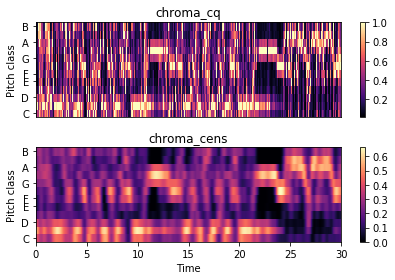

In [21]:
showing_x = x[:cut_off_time *x_sr]
# showing_x = x
x_chroma_cens = librosa.feature.chroma_cens(y=showing_x, sr=sr)
x_chroma_cq = librosa.feature.chroma_cqt(y=showing_x, sr=sr)

x_cqt = librosa.cqt(showing_x, sr=sr, hop_length=hop_length)
x_cqt_mag = librosa.amplitude_to_db(abs(x_cqt))

import matplotlib.pyplot as plt
plt.figure()
plt.subplot(2,1,1)
librosa.display.specshow(x_chroma_cq, y_axis='chroma')
plt.title('chroma_cq')
plt.colorbar()
plt.subplot(2,1,2)
librosa.display.specshow(x_chroma_cens, y_axis='chroma', x_axis='time')
plt.title('chroma_cens')
plt.colorbar()
plt.tight_layout()
print("shape",x_chroma_cens.shape)

In [12]:
def dtw_table(x, y, distance=None):
    if distance is None:
        distance = scipy.spatial.distance.euclidean
    nx = len(x)
    ny = len(y)
    table = numpy.zeros((nx+1, ny+1))
    
    # Compute left column separately, i.e. j=0.
    table[1:, 0] = numpy.inf
        
    # Compute top row separately, i.e. i=0.
    table[0, 1:] = numpy.inf
        
    # Fill in the rest.
    for i in range(1, nx+1):
        for j in range(1, ny+1):
            d = distance(x[i-1], y[j-1])
            table[i, j] = d + min(table[i-1, j], table[i, j-1], table[i-1, j-1])
    return table

def dtw(x, y, table):
    i = len(x)
    j = len(y)
    path = [(i, j)]
    while i > 0 or j > 0:
        minval = numpy.inf
        if table[i-1][j-1] < minval:
            minval = table[i-1, j-1]
            step = (i-1, j-1)
        if table[i-1, j] < minval:
            minval = table[i-1, j]
            step = (i-1, j)
        if table[i][j-1] < minval:
            minval = table[i, j-1]
            step = (i, j-1)
        path.insert(0, step)
        i, j = step
    return numpy.array(path)

In [22]:
# Running DTW
import scipy, IPython.display as ipd
D = dtw_table(y_chroma_cens.T, x_chroma_cens.T, distance=scipy.spatial.distance.cityblock)
path = dtw(y_chroma_cens.T, x_chroma_cens.T, D)
print("path.shape:",path.shape)
hop_length = 256
i1, i2 = librosa.frames_to_samples(path[300], hop_length=hop_length)
print(i1, i2)


path.shape: (1480, 2)
76800 63232


In [14]:
print(len(path), path.shape)

947 (947, 2)


In [90]:
ipd.Audio(x[i1:], rate=sr)

In [91]:
ipd.Audio(y[i2:], rate=sr)

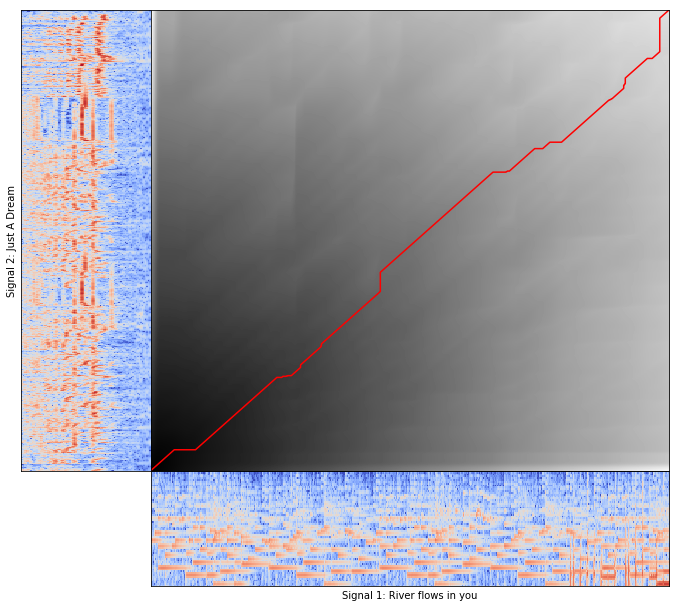

In [23]:
plt.figure(figsize=(9, 8))

# Bottom right plot.
ax1 = plt.axes([0.2, 0, 0.8, 0.20])
ax1.imshow(y_cqt_mag, origin='lower', aspect='auto', cmap='coolwarm')
ax1.set_xlabel('Signal 1: River flows in you')
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_ylim(20)

# Top left plot.
ax2 = plt.axes([0, 0.2, 0.20, 0.8])
ax2.imshow(x_cqt_mag.T[:,::-1], origin='lower', aspect='auto', cmap='coolwarm')
ax2.set_ylabel('Signal 2: Just A Dream')
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_ylim(20)

# Top right plot.
ax3 = plt.axes([0.2, 0.2, 0.8, 0.8])
ax3.imshow(D.T, aspect='auto', origin='lower', interpolation='nearest', cmap='gray')
ax3.set_xticks([])
ax3.set_yticks([])

# Path.
ax3.plot(path[:,0], path[:,1], 'r')

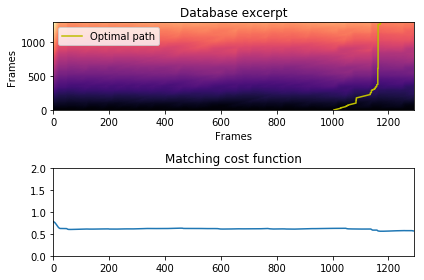

In [27]:
D, wp = librosa.dtw(y_chroma_cens, x_chroma_cens, subseq=True)
plt.subplot(2, 1, 1)
librosa.display.specshow(D, x_axis='frames', y_axis='frames')
plt.title('Database excerpt')
plt.plot(wp[:, 1], wp[:, 0], label='Optimal path', color='y')
plt.legend()
plt.subplot(2, 1, 2)
plt.plot(D[-1, :] / wp.shape[0])
plt.xlim([0, x_chroma_cens.shape[1]])
plt.ylim([0, 2])
plt.title('Matching cost function')
plt.tight_layout()
plt.show()

[]

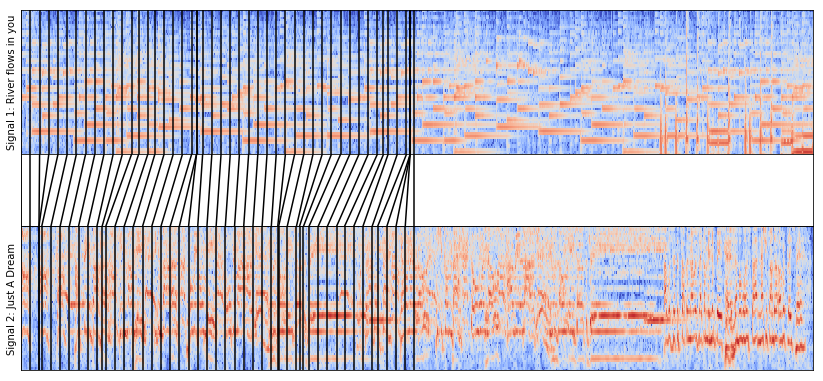

In [24]:
#Visualize their alignment
plt.figure(figsize=(11, 5))

# Top plot.
ax1 = plt.axes([0, 0.60, 1, 0.40])
ax1.imshow(y_cqt_mag, origin='lower', aspect='auto', cmap='coolwarm')
ax1.set_ylabel('Signal 1: River flows in you')
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_ylim(20)
ax1.set_xlim(0, y_cqt.shape[1])

# Bottom plot.
ax2 = plt.axes([0, 0, 1, 0.40])
ax2.imshow(x_cqt_mag, origin='lower', aspect='auto', cmap='coolwarm')
ax2.set_ylabel('Signal 2: Just A Dream')
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_ylim(20)
ax2.set_xlim(0, x_cqt.shape[1])

# Middle plot.
line_color = 'k'
step = 30
n1 = float(y_cqt.shape[1])
n2 = float(x_cqt.shape[1])
ax3 = plt.axes([0, 0.40, 1, 0.20])
for t in path[::step]:
    ax3.plot((t[0]/n1, t[1]/n2), (1, -1), color=line_color)
    ax3.set_xlim(0, 1)
    ax3.set_ylim(-1, 1)

# Path markers on top and bottom plot.
y1_min, y1_max = ax1.get_ylim()
y2_min, y2_max = ax2.get_ylim()
ax1.vlines([t[0] for t in path[::step]], y1_min, y1_max, color=line_color)
ax2.vlines([t[1] for t in path[::step]], y2_min, y2_max, color=line_color)
ax3.set_xticks([])
ax3.set_yticks([])